In [ ]:
#import fastai.vision.all as fv
import torch
import torch.nn as nn
import torch.nn.functional as F
from pathlib import Path
import random
from pathlib import Path
#from math import prod
#from fastai.vision.all import delegates

In [ ]:
!pip install muda

     |████████████████████████████████| 61kB 2.9MB/s 
     |████████████████████████████████| 61kB 4.0MB/s 
     |████████████████████████████████| 92kB 3.7MB/s 
  Created wheel for muda: filename=muda-0.4.1-cp36-none-any.whl size=20485 sha256=ca9a299599ff606934f631323f1b9112daa7430c0a4ce0140f1decc337091191
  Stored in directory: /root/.cache/pip/wheels/66/fe/d9/4e36886f227e3b9681b168ace4c4ad52760d8dcdd76e4e6afa
  Created wheel for pyrubberband: filename=pyrubberband-0.3.0-cp36-none-any.whl size=4283 sha256=29529ac014b373ac0c31391adcc0f177a05d840a5e818c6d09dd65aca1dbd1c9
  Stored in directory: /root/.cache/pip/wheels/aa/b3/2e/e1f66716b0d9b1e18136227ee204682100d837e72c5ea57b1d
  Created wheel for jams: filename=jams-0.3.4-cp36-none-any.whl size=64925 sha256=3690559380f138158530a9644b174cb256924a08ddc042570f613b99bade8002
  Stored in directory: /root/.cache/pip/wheels/2b/b8/c7/092096a3af0eb864cca4e79a44bc883dee5b9767da2c6f8ab3
  Created wheel for mir-eval: filename=mir_eval-0.6-cp36-none

In [ ]:
torch.cuda.is_available()

False

In [ ]:
USE_GOOGLE_COLAB = True
ROOT_FOLDER_NAME = 'US8K'

if USE_GOOGLE_COLAB:
    # mount google drive
    from google.colab import drive 
    drive.mount('/content/gdrive')

    # create and change working directory
    %cd gdrive/'My Drive'

%mkdir $ROOT_FOLDER_NAME
%cd $ROOT_FOLDER_NAME

Mounted at /content/gdrive
/content/gdrive/My Drive
mkdir: cannot create directory ‘US8K’: File exists
/content/gdrive/My Drive/US8K


In [ ]:
DOWNLOAD_DATASET = False
EXTRACT_DATASET = False

DATASET_URL = "https://goo.gl/8hY5ER"

if DOWNLOAD_DATASET:
    !wget $DATASET_URL


In [ ]:
if EXTRACT_DATASET:
    !tar xzvf 8hY5ER

In [ ]:
#!cp 8hY5ER /content/drive/MyDrive/

In [ ]:
#!cp -r /content/UrbanSound8K /content/drive/MyDrive/

# Aqui empieza este pex

In [ ]:


import os

import librosa
import numpy as np
import pandas as pd

from tqdm import tqdm


In [ ]:

# set paths to the UrbanSound8K dataset and metadata file
US8K_AUDIO_PATH = os.path.abspath('UrbanSound8K/audio/')
US8K_METADATA_PATH = os.path.abspath('UrbanSound8K/metadata/UrbanSound8K.csv')

In [ ]:
us8k_metadata_df = pd.read_csv(US8K_METADATA_PATH,
                               usecols=["slice_file_name", "fold", "classID"],
                               dtype={"fold": "uint8", "classID" : "uint8"})

#us8k_metadata_df = pd.read_csv(US8K_METADATA_PATH)
us8k_metadata_df

,slice_file_name,fold,classID
0,100032-3-0-0.wav,5,3
1,100263-2-0-117.wav,5,2
2,100263-2-0-121.wav,5,2
3,100263-2-0-126.wav,5,2
4,100263-2-0-137.wav,5,2
...,...,...,...
8727,99812-1-2-0.wav,7,1
8728,99812-1-3-0.wav,7,1
8729,99812-1-4-0.wav,7,1
8730,99812-1-5-0.wav,7,1


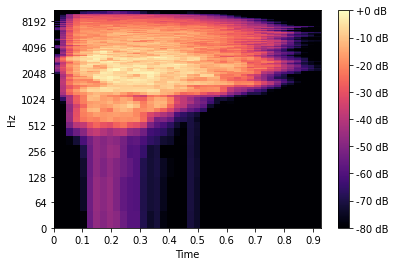

In [ ]:
import librosa.display
import matplotlib.pyplot as plt

n_fft = 2048
hop_length = 512
y, sr = librosa.load('UrbanSound8K/audio/fold4/35799-6-0-0.wav')
whale_song, _ = librosa.effects.trim(y)

n_mels = 128
mel = librosa.filters.mel(sr=sr, n_fft=n_fft, n_mels=n_mels)

S = librosa.feature.melspectrogram(whale_song, sr=sr, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)
S_DB = librosa.power_to_db(S, ref=np.max)
librosa.display.specshow(S_DB, sr=sr, hop_length=hop_length, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')

In [ ]:


HOP_LENGTH = 512        # number of samples between successive frames
WINDOW_LENGTH = 512     # length of the window in samples
N_MEL = 128             # number of Mel bands to generate


def compute_melspectrogram_with_fixed_length(audio, sampling_rate, num_of_samples=128):
    try:
        # compute a mel-scaled spectrogram
        melspectrogram = librosa.feature.melspectrogram(y=audio, 
                                                        sr=sampling_rate, 
                                                        hop_length=HOP_LENGTH,
                                                        win_length=WINDOW_LENGTH, 
                                                        n_mels=N_MEL)

        # convert a power spectrogram to decibel units (log-mel spectrogram)
        melspectrogram_db = librosa.power_to_db(melspectrogram, ref=np.max)
        
        melspectrogram_length = melspectrogram_db.shape[1]
        
        # pad or fix the length of spectrogram 
        if melspectrogram_length != num_of_samples:
            melspectrogram_db = librosa.util.fix_length(melspectrogram_db, 
                                                        size=num_of_samples, 
                                                        axis=1, 
                                                        constant_values=(0, -80.0))
    except Exception as e:
        print("\nError encountered while parsing files\n>>", e)
        return None 
    
    return melspectrogram_db



In [ ]:
SOUND_DURATION = 2.95   # fixed duration of an audio excerpt in seconds

features = []

# iterate through all dataset examples and compute log-mel spectrograms
for index, row in tqdm(us8k_metadata_df.iterrows(), total=len(us8k_metadata_df)):
    file_path = f'{US8K_AUDIO_PATH}/fold{row["fold"]}/{row["slice_file_name"]}'
    audio, sample_rate = librosa.load(file_path, duration=SOUND_DURATION, res_type='kaiser_fast')
    
    melspectrogram = compute_melspectrogram_with_fixed_length(audio, sample_rate)
    label = row["classID"]
    fold = row["fold"]
    
    features.append([melspectrogram, label, fold])

# convert into a Pandas DataFrame 
us8k_df = pd.DataFrame(features, columns=["melspectrogram", "label", "fold"])

 41%|████      | 3555/8732 [04:22<22:58,  3.76it/s]/usr/local/lib/python3.6/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1323
  n_fft, y.shape[-1]
 95%|█████████▌| 8326/8732 [16:28<01:04,  6.25it/s]/usr/local/lib/python3.6/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1103
  n_fft, y.shape[-1]
 95%|█████████▌| 8329/8732 [16:28<01:32,  4.36it/s]/usr/local/lib/python3.6/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1523
  n_fft, y.shape[-1]
100%|██████████| 8732/8732 [17:36<00:00,  8.26it/s]


In [ ]:
!pwd

/content/gdrive/My Drive/US8K


In [ ]:
# write the Pandas DataFrame object to .pkl file
WRITE_DATA = True

if WRITE_DATA:
  us8k_df.to_pickle("us8k_df.pkl")

# Experimentos xD

In [ ]:
import nlpaug

In [ ]:
!pip install nlpaug

     |████████████████████████████████| 389kB 5.3MB/s 


In [ ]:
import nlpaug.augmenter.audio as naa

from nlpaug.util.audio.visualizer import AudioVisualizer

In [ ]:
import librosa
import librosa.display as librosa_display
import matplotlib.pyplot as plt

#file_path = '/content/gdrive/MyDrive/US8K/UrbanSound8K/audio/fold1/103258-5-0-1.wav'
#file_path = '../test/res/audio/' + file_path
#data, sr = librosa.load(file_path)


# mas experimentos gg

In [ ]:
import glob
import os
import librosa
import librosa.display
#import librosa.logamplitude
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import specgram
%matplotlib inline
plt.style.use('ggplot')

In [ ]:
def load_sound_files(parent_dir, file_paths):
    raw_sounds = []
    for fp in file_paths:
        X,sr = librosa.load(parent_dir + fp)
        raw_sounds.append([X,sr])
    return raw_sounds

def plot_waves(sound_names,raw_sounds):
    i = 1
    fig = plt.figure(figsize=(25,10), dpi = 900)
    for n,f in zip(sound_names,raw_sounds):
        plt.subplot(2,5,i)
        librosa.display.waveplot(np.array(f[0]),sr=22050)
        plt.title(n.title())
        i += 1
    plt.suptitle('Figure 1: Waveplot',x=0.5, y=0.95,fontsize=18)
    plt.show()
    
def plot_specgram(sound_names,raw_sounds):
  i = 1
  fig = plt.figure(figsize=(25,10), dpi = 900)
  for n,f in zip(sound_names,raw_sounds):
    plt.subplot(2,5,i)
    plt.title(n.title())

    n_fft = 2048
    hop_length = 512
    whale_song, _ = librosa.effects.trim(np.array(f[0]))

    n_mels = 128
    #mel = librosa.filters.mel(sr=sr, n_fft=n_fft, n_mels=n_mels)
    S = librosa.feature.melspectrogram(whale_song, sr=f[1], n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)
    S_DB = librosa.power_to_db(S, ref=np.max)
    librosa.display.specshow(S_DB, sr=f[1], hop_length=hop_length, x_axis='time', y_axis='mel')
    i+=1
  plt.suptitle('Figure 2: Spectrogram',x=0.5, y=0.95,fontsize=18)
  plt.colorbar(format='%+2.0f dB')
  plt.show()

def plot_log_power_specgram(sound_names,raw_sounds):
    i = 1
    fig = plt.figure(figsize=(25,10), dpi = 900)
    for n,f in zip(sound_names,raw_sounds):
        plt.subplot(2,5,i)
        D = librosa.amplitude_to_db(np.abs(librosa.stft(f[0]))**2, ref=np.max)
        librosa.display.specshow(D,x_axis='time' ,y_axis='log')
        plt.title(n.title())
        i += 1
    plt.suptitle('Figure 3: Log power spectrogram',x=0.5, y=0.95,fontsize=18)
    plt.show()


In [ ]:
sound_file_paths = ["aircon.wav", "carhorn.wav", "play.wav", "dogbark.wav", "drill.wav",
                   "engine.wav","gunshots.wav","jackhammer.wav","siren.wav","music.wav"]
sound_names = ["air conditioner","car horn","children playing","dog bark","drilling","engine idling",
               "gun shot","jackhammer","siren","street music"]

#parent_dir = 'samples/us8k/'
parent_dir = '/content/gdrive/MyDrive/US8K/deep-listening/samples/us8k/'

raw_sounds = load_sound_files(parent_dir, sound_file_paths)

In [ ]:
plot_waves(sound_names, raw_sounds)
plot_specgram(sound_names, raw_sounds)
plot_log_power_specgram(sound_names, raw_sounds)

## Con data augmenta Augmentation

In [ ]:
def load_sound_files(parent_dir, file_paths):
    raw_sounds = []
    for fp in file_paths:
        X,sr = librosa.load(parent_dir + fp)

        aug = naa.SpeedAug()
        data_aug = aug.augment(X)

        aug = naa.PitchAug(sampling_rate=sr, factor=(2,3))
        data_aug = aug.augment(data_aug)

        aug = naa.ShiftAug(sampling_rate=sr,duration=1)
        data_aug = aug.augment(data_aug)

        aug = naa.NoiseAug()
        data_aug = aug.augment(data_aug)


        raw_sounds.append([X,sr,data_aug])
    return raw_sounds

def plot_waves(sound_names,raw_sounds):
    i = 1
    fig = plt.figure(figsize=(25,10), dpi = 900)
    for n,f in zip(sound_names,raw_sounds):
        plt.subplot(2,5,i)
        #librosa.display.waveplot(np.array(f[0]),sr=22050)

        librosa.display.waveplot(np.array(f[0]), sr=f[1], alpha=0.5)
        librosa.display.waveplot(np.array(f[2]), sr=f[1], color='b', alpha=0.25)
        
        plt.title(n.title())
        i += 1
    plt.suptitle('Figure 1: Waveplot',x=0.5, y=0.95,fontsize=18)
    plt.show()
    
def plot_specgram(sound_names,raw_sounds):
  i = 1
  fig = plt.figure(figsize=(25,10), dpi = 900)
  for n,f in zip(sound_names,raw_sounds):
    plt.subplot(2,5,i)
    plt.title(n.title())

    n_fft = 2048
    hop_length = 512
    whale_song, _ = librosa.effects.trim(np.array(f[2]))

    n_mels = 128
    #mel = librosa.filters.mel(sr=sr, n_fft=n_fft, n_mels=n_mels)
    S = librosa.feature.melspectrogram(whale_song, sr=f[1], n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)
    S_DB = librosa.power_to_db(S, ref=np.max)
    librosa.display.specshow(S_DB, sr=f[1], hop_length=hop_length, x_axis='time', y_axis='mel')
    i+=1
  plt.suptitle('Figure 2: Spectrogram',x=0.5, y=0.95,fontsize=18)
  plt.colorbar(format='%+2.0f dB')
  plt.show()

def plot_log_power_specgram(sound_names,raw_sounds):
    i = 1
    fig = plt.figure(figsize=(25,10), dpi = 900)
    for n,f in zip(sound_names,raw_sounds):
        plt.subplot(2,5,i)
        D = librosa.amplitude_to_db(np.abs(librosa.stft(f[2]))**2, ref=np.max)
        librosa.display.specshow(D,x_axis='time' ,y_axis='log')
        plt.title(n.title())
        i += 1
    plt.suptitle('Figure 3: Log power spectrogram',x=0.5, y=0.95,fontsize=18)
    plt.show()


In [ ]:
sound_file_paths = ["aircon.wav", "carhorn.wav", "play.wav", "dogbark.wav", "drill.wav",
                   "engine.wav","gunshots.wav","jackhammer.wav","siren.wav","music.wav"]
sound_names = ["air conditioner","car horn","children playing","dog bark","drilling","engine idling",
               "gun shot","jackhammer","siren","street music"]

#parent_dir = 'samples/us8k/'
parent_dir = '/content/gdrive/MyDrive/US8K/deep-listening/samples/us8k/'

raw_sounds = load_sound_files(parent_dir, sound_file_paths)

In [ ]:
plot_waves(sound_names, raw_sounds)
plot_specgram(sound_names, raw_sounds)
plot_log_power_specgram(sound_names, raw_sounds)

In [ ]:

HOP_LENGTH = 512        # number of samples between successive frames
WINDOW_LENGTH = 512     # length of the window in samples
N_MEL = 128             # number of Mel bands to generate


def compute_melspectrogram_with_fixed_length_and_aug(audio, sampling_rate, num_of_samples=128):
    try:
        #Augmentations
        #X,sr = librosa.load(parent_dir + fp)

        sr=sampling_rate

        aug = naa.SpeedAug()
        data_aug = aug.augment(audio)

        aug = naa.PitchAug(sampling_rate=sr, factor=(2,3))
        data_aug = aug.augment(data_aug)

        aug = naa.ShiftAug(sampling_rate=sr,duration=1)
        data_aug = aug.augment(data_aug)

        aug = naa.NoiseAug()
        data_aug = aug.augment(data_aug)


        # compute a mel-scaled spectrogram
        melspectrogram = librosa.feature.melspectrogram(y=data_aug, 
                                                        sr=sampling_rate, 
                                                        hop_length=HOP_LENGTH,
                                                        win_length=WINDOW_LENGTH, 
                                                        n_mels=N_MEL)

        # convert a power spectrogram to decibel units (log-mel spectrogram)
        melspectrogram_db = librosa.power_to_db(melspectrogram, ref=np.max)
        
        melspectrogram_length = melspectrogram_db.shape[1]
        
        # pad or fix the length of spectrogram 
        if melspectrogram_length != num_of_samples:
            melspectrogram_db = librosa.util.fix_length(melspectrogram_db, 
                                                        size=num_of_samples, 
                                                        axis=1, 
                                                        constant_values=(0, -80.0))
    except Exception as e:
        print("\nError encountered while parsing files\n>>", e)
        return None 
    
    return melspectrogram_db


In [ ]:
SOUND_DURATION = 2.95   # fixed duration of an audio excerpt in seconds

features = []

# iterate through all dataset examples and compute log-mel spectrograms
for index, row in tqdm(us8k_metadata_df.iterrows(), total=len(us8k_metadata_df)):
    file_path = f'{US8K_AUDIO_PATH}/fold{row["fold"]}/{row["slice_file_name"]}'
    audio, sample_rate = librosa.load(file_path, duration=SOUND_DURATION, res_type='kaiser_fast')
    
    melspectrogram = compute_melspectrogram_with_fixed_length_and_aug(audio, sample_rate)
    label = row["classID"]
    fold = row["fold"]
    
    features.append([melspectrogram, label, fold])

# convert into a Pandas DataFrame 
us8k_df_aug = pd.DataFrame(features, columns=["melspectrogram_aug", "label", "fold"])

 24%|██▍       | 2120/8732 [31:07<1:46:04,  1.04it/s]/usr/local/lib/python3.6/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1852
  n_fft, y.shape[-1]
/usr/local/lib/python3.6/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1752
  n_fft, y.shape[-1]
 24%|██▍       | 2122/8732 [31:08<1:39:31,  1.11it/s]/usr/local/lib/python3.6/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1282
  n_fft, y.shape[-1]
/usr/local/lib/python3.6/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1368
  n_fft, y.shape[-1]
 24%|██▍       | 2123/8732 [31:09<1:38:52,  1.11it/s]/usr/local/lib/python3.6/dist-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1452
  n_fft, y.shape[-1]
/usr/local/lib/python3.6/dist-packages/librosa

In [ ]:
# write the Pandas DataFrame object to .pkl file
WRITE_DATA = True

if WRITE_DATA:
  us8k_df_aug.to_pickle("us8k_aug_df.pkl")

#Experimentos con muda jeje no me canso de los experimentos :'vc

In [ ]:
import muda.deformers

In [ ]:
# y, sr = librosa.load('UrbanSound8K/audio/fold4/35799-6-0-0.wav')
D = muda.deformers.PitchShift(n_semitones=2.0)

In [ ]:
print(D)

PitchShift(n_semitones=[2.0])


In [ ]:
!more UrbanSound8K-JAMS/data/fold1/pitch1/jams/101415-3-0-2_pitch0.jams 

{
  "sandbox": {
    "muda": {
      "state": [], 
      "version": {
        "librosa": "0.4.2", 
        "muda": "0.1.1", 
        "pysoundfile": "0.8.1", 
        "jams": "0.2.1"
      }, 
      "history": [
        {
          "transformer": {
            "params": {
              "n_semitones": -2
            }, 
            "__class__": "PitchShift"
          }, 
          "state": {
            "tuning": -0.32000000000000001, 
            "n_semitones": -2
          }
        }
      ]
    }
  }, 
  "annotations": [
    {
      "namespace": "tag_open", 
      "sandbox": {
        "classID": 3, 
        "end": 5.0, 
        "fold": 1, 
        "start": 1.0, 
        "salience": 1, 
        "slice_file_name": "101415-3-0-2.wav", 
        "class": "dog_bark", 
        "fsID": 101415
      }, 
      "time": 0, 
      "duration": 4.0, 
      "annotation_metadata": {
        "annotation_tools": "Sonic Visualiser", 
        "curator": {
          "name": "Justin Salamon", 
          "e

In [ ]:
j_orig = muda.load_jam_audio('/content/gdrive/MyDrive/US8K/UrbanSound8K-JAMS/data/fold1/pitch1/jams/101415-3-0-2_pitch0.jams', '/content/gdrive/MyDrive/US8K/UrbanSound8K/audio/fold1/101415-3-0-2.wav')


In [ ]:
print(type(j_orig))

<class 'jams.core.JAMS'>


In [ ]:
!pip install -U jams

Requirement already up-to-date: jams in /usr/local/lib/python3.6/dist-packages (0.3.4)


In [ ]:
import jams
import librosa.display

In [ ]:
another_jam = jams.load('/content/gdrive/MyDrive/US8K/UrbanSound8K-JAMS/data/fold1/pitch1/jams/101415-3-0-2_pitch0.jams')

In [ ]:
another_jam

<JAMS(file_metadata=<FileMetadata(...)>,
      annotations=[1 annotation],
      sandbox=<Sandbox(...)>)>

In [ ]:
def load_jam_audio(jam_in, audio_file, validate=True, strict=True, fmt="auto", **kwargs):
    """Load a jam and pack it with audio.

    Parameters
    ----------
    jam_in : str, file descriptor, jams.JAMS, or None
        JAMS filename, open file-descriptor, or object to load.
        See ``jams.load`` for acceptable formats.

        If `None` is provided, an empty JAMS object is constructed.

    audio_file : str
        Audio filename to load

    validate : bool
    strict : bool
    fmt : str
        Parameters to `jams.load`

    kwargs : additional keyword arguments
        See `librosa.load`

    Returns
    -------
    jam : jams.JAMS
        A jams object with audio data in the top-level sandbox

    Notes
    -----
    This operation can modify the `file_metadata.duration` field of `jam_in`:
    If it is not currently set, it will be populated with the duration of the
    audio file.

    See Also
    --------
    jams.load
    librosa.core.load


    Examples
    --------

    Load a JAMS object and audio from disk

    >>> jam = muda.load_jam_audio('my_file.jams', 'my_file.wav')


    Load an audio file with no jams annotation

    >>> jam = muda.load_jam_audio(None, 'my_file.wav')

    """

    if isinstance(jam_in, jams.JAMS):
        jam = jam_in
    elif jam_in is None:
        jam = jams.JAMS()
    else:
        jam = jams.load(jam_in, validate=validate, strict=strict, fmt=fmt)

    y, sr = librosa.load(audio_file, **kwargs)

    #return y,sr
    if jam.file_metadata.duration is None:
        jam.file_metadata.duration = librosa.get_duration(y=y, sr=sr)

    return muda.jam_pack(jam, _audio=dict(y=y, sr=sr)) 

In [ ]:
#jam = muda.load_jam_audio('my_file.jams', 'my_file.wav')
another_jam = muda.load_jam_audio('/content/gdrive/MyDrive/US8K/UrbanSound8K-JAMS/data/fold1/pitch2/jams/103074-7-0-0_pitch3-3.jams','/content/gdrive/MyDrive/US8K/UrbanSound8K/audio/fold1/103074-7-0-0.wav')

In [ ]:
type(another_jam)
#y, sr = librosa.load(another_jam)
another_jam

<JAMS(file_metadata=<FileMetadata(...)>,
      annotations=[1 annotation],
      sandbox=<Sandbox(...)>)>

In [ ]:
#h=load_jam_audio('/content/gdrive/MyDrive/US8K/UrbanSound8K-JAMS/data/fold1/bgnoise/jams/103074-7-0-0_bgnoise3.jams')
#h

In [ ]:
x=dict(another_jam.sandbox.muda)['history'][0]
print(x['transformer']['params'])
# print(x)
string=x['transformer']['__class__']+(str(x['transformer']['params']))
string

{'n_semitones': 3.5}


"PitchShift{'n_semitones': 3.5}"

In [ ]:
import json
x=another_jam.sandbox.muda.history
#a=zip(x['__class__'],x['params'])
#x
#y=muda.deserialize(json.loads(x))
#json?
pipeline = muda.Pipeline(steps=[('pitch_shift', another_jam.sandbox.muda.history[0])])

TypeError: ignored

In [ ]:
.#import muda.Pipeline
#for j_new in muda.Pipeline.transform(another_jam):
#  process(j_new)

ModuleNotFoundError: ignored

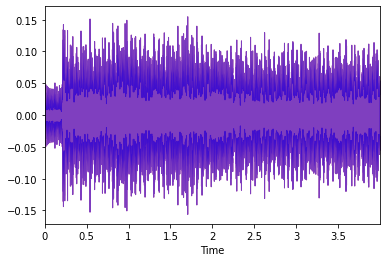

In [ ]:
librosa.display.waveplot(another_jam.sandbox.muda._audio['y'], sr=another_jam.sandbox.muda._audio['sr'],color='r', alpha=0.5)
librosa.display.waveplot(y2, sr=sr2,color='b', alpha=0.5)

In [ ]:
# '/content/gdrive/MyDrive/US8K/UrbanSound8K/audio/fold1/101415-3-0-2.wav'

In [ ]:
y2, sr2 = librosa.load('/content/gdrive/MyDrive/US8K/UrbanSound8K/audio/fold1/103074-7-0-0.wav')

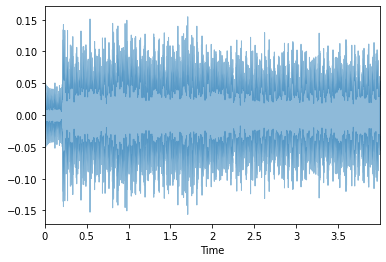

In [ ]:
librosa.display.waveplot(y2, sr=sr2, alpha=0.5)

In [ ]:
j_orig = jams.load('/content/gdrive/MyDrive/US8K/UrbanSound8K-JAMS/data/fold1/bgnoise/jams/103074-7-0-0_bgnoise3.jams')

In [ ]:
j_orig.sandbox.muda

{'history': [{'state': {'filename': '/Users/justin/datasets/UrbanSound8K/deepsonyc/background_noise/converted/268903__yonts__city-park-tel-aviv-israel.wav',
    'weight': 0.3174775329706806},
   'transformer': {'__class__': 'BackgroundNoise',
    'params': {'files': ['/Users/justin/datasets/UrbanSound8K/deepsonyc/background_noise/converted/150993__saphe__street-scene-1.wav',
      '/Users/justin/datasets/UrbanSound8K/deepsonyc/background_noise/converted/173955__saphe__street-scene-3.wav',
      '/Users/justin/datasets/UrbanSound8K/deepsonyc/background_noise/converted/207208__jormarp__high-street-of-gandia-valencia-spain.wav',
      '/Users/justin/datasets/UrbanSound8K/deepsonyc/background_noise/converted/268903__yonts__city-park-tel-aviv-israel.wav'],
     'n_samples': 1,
     'weight_max': 0.5,
     'weight_min': 0.1}}}],
 'state': [],
 'version': {'jams': '0.2.1',
  'librosa': '0.4.2',
  'muda': '0.1.1',
  'pysoundfile': '0.8.1'}}

In [ ]:
another_jam.sandbox.muda

<Sandbox(_audio={'y': array([-0.00011783, -0.00017157, -0.00017749, ..., -0.04598654,
                -0.04624664, -0.05089863], dtype=float32), 'sr': 22050},
         history=[{'transformer': {'params': {'files': ['/Users/justin/datasets/UrbanSound8K/deepsonyc/background_noise/converted/150993__saphe__street-scene-1.wav', '/Users/justin/datasets/UrbanSound8K/deepsonyc/background_noise/converted/173955__saphe__street-scene-3.wav', '/Users/justin/datasets/UrbanSound8K/deepsonyc/background_noise/converted/207208__jormarp__high-street-of-gandia-valencia-spain.wav', '/Users/justin/datasets/UrbanSound8K/deepsonyc/background_noise/converted/268903__yonts__city-park-tel-aviv-israel.wav'], 'weight_max': 0.5, 'weight_min': 0.1, 'n_samples': 1}, '__class__': 'BackgroundNoise'}, 'state': {'weight': 0.3174775329706806, 'filename': '/Users/justin/datasets/UrbanSound8K/deepsonyc/background_noise/converted/268903__yonts__city-park-tel-aviv-israel.wav'}}],
         state=[],
         version={'librosa': '0.4.2', 'muda': '0.1.1', 'pysoundfile': '0.8.1', 'jams': '0.2.1'})>

In [ ]:
D = muda.deformers.PitchShift(n_semitones=-0.5)
type(D)

muda.deformers.pitch.PitchShift

In [ ]:
print(str(D))

PitchShift(n_semitones=[-0.5])
